In [1]:
import numpy as np
import matplotlib.pylab as plt
from scipy.fftpack import fft, ifft,fftshift,ifftshift
from IPython.display import Audio
from scipy.io import wavfile

In [2]:
filename="labikina.wav" # set the path were the file is, in my case i have it in the same folder
fs, data = wavfile.read(filename) # fs is the frequency, data is an array with the values of the song (shape=(3969000, 2))
audio=data.reshape(data.shape[0]*2) # we reshape our data to get the audio




Audio(data=audio,rate=2*fs)

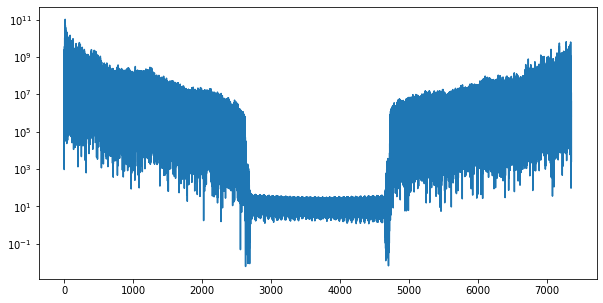

In [3]:
audio=data.reshape(data.shape[0]*2)
Fourier=fft(audio) # compute the FFT
N=len(audio)
plt.figure(figsize=(10,5))
frequencies=np.fft.fftfreq(N,d=3/(fs))
norm_Fourier=(Fourier*Fourier.conjugate()).real
plt.plot(frequencies[:N//2],norm_Fourier[:N//2]/N)
plt.yscale("log")

Fourier[(np.abs(frequencies)<200)]=0
Fourier[(np.abs(frequencies)>600)]=0
Fourier[(np.abs(frequencies)>=200) & (np.abs(frequencies)<=600)]=Fourier[(np.abs(frequencies)>=200) & (np.abs(frequencies)<=600)] * 0.8
#No se escucha la guitarra y es más aguda 


tmp=ifft(Fourier).real
Audio(data=tmp,rate=2*fs)

In [4]:
audio=data.reshape(data.shape[0]*2)
Fourier=fft(audio) # compute the FFT
N=len(audio)
frequencies=np.fft.fftfreq(N,d=1/(fs))
#norm_Fourier=(Fourier*Fourier.conjugate()).real
#plt.plot(frequencies[:N//2],norm_Fourier[:N//2]/N)
#plt.yscale("log")

Fourier[(np.abs(frequencies)>90) & (np.abs(frequencies)<190)]=Fourier[(np.abs(frequencies)>90) & (np.abs(frequencies)<190)]*(7+3j)
Fourier[(np.abs(frequencies)<90) | (np.abs(frequencies)>190)]=0

#Solo la guitarra, y resaltarlo, pero luis miguel tiene mucho rango entonces no se puede aislar.  


tmp=ifft(Fourier).real
Audio(data=tmp,rate=2*fs)